SymPy implementation of the anaytical model for 3-dof training rig

In [1]:
import sympy as sp

In [2]:
t = sp.symbols('t')

q1 = sp.Function('q1')(t)
q2 = sp.Function('q2')(t)
q3 = sp.Function('q3')(t)

q = sp.Matrix([q1, q2, q3])
qd = q.diff(t)

In [3]:
g, Lb, Lc, ma, mb, mc = sp.symbols('g Lb Lc ma mb mc')

Ibx, Iby, Ibz = sp.symbols('Ibx Iby Ibz')
Icx, Icy, Icz = sp.symbols('Icx Icy Icz')

Ib = sp.diag(Ibx, Iby, Ibz)
Ic = sp.diag(Icx, Icy, Icz)

LT = Lb + Lc
xO = (Lb - Lc)/2

In [4]:
R1 = sp.Matrix([
    [1, 0, 0],
    [0, sp.cos(q3), -sp.sin(q3)],
    [0, sp.sin(q3),  sp.cos(q3)]
])

R2 = sp.Matrix([
    [sp.cos(q2), 0, sp.sin(q2)],
    [0, 1, 0],
    [-sp.sin(q2), 0, sp.cos(q2)]
])

R3 = sp.Matrix([
    [sp.cos(q1), -sp.sin(q1), 0],
    [sp.sin(q1),  sp.cos(q1), 0],
    [0, 0, 1]
])

C = R3 * R2 * R1

In [5]:
def vee(S):
    return sp.Matrix([S[2,1], S[0,2], S[1,0]])

omega_A = vee(C.T * C.diff(t))         # body-frame angular velocity
B = omega_A.jacobian(qd)               # omega_A = B * qd
omega_N = C * omega_A                  # inertial-frame angular velocity

In [6]:
rO_A = sp.Matrix([0, 0, xO])
rB_A = sp.Matrix([0, 0, Lb])
rC_A = sp.Matrix([0, 0, -Lc])

# Transform to inertial frame
rO = C * rO_A
rB = C * rB_A
rC = C * rC_A


vO = rO.diff(t)
vB = rB.diff(t)
vC = rC.diff(t)

vO_cross = omega_N.cross(rO)
vB_cross = omega_N.cross(rB)
vC_cross = omega_N.cross(rC)

kinematics_residual = sp.Matrix.vstack(
    vO - vO_cross,
    vB - vB_cross,
    vC - vC_cross
)

Ia_perp = ma*(Lb**3 + Lc**3)/(3*LT)
Ia = sp.diag(Ia_perp, Ia_perp, 0)

In [7]:
T_trans = (
    sp.Rational(1,2)*ma*(vO.dot(vO)) +
    sp.Rational(1,2)*mb*(vB.dot(vB)) +
    sp.Rational(1,2)*mc*(vC.dot(vC))
)

T_rot = (
    sp.Rational(1,2)*(omega_A.T * Ia * omega_A)[0] +
    sp.Rational(1,2)*(omega_A.T * Ib * omega_A)[0] +
    sp.Rational(1,2)*(omega_A.T * Ic * omega_A)[0]
)

K = T_trans + T_rot

In [8]:
gvec = sp.Matrix([-g, 0, 0])

P = (
    ma*(gvec.dot(rO)) +
    mb*(gvec.dot(rB)) +
    mc*(gvec.dot(rC))
)

In [14]:
# External wrench input (applied at point B): torque + force
tau1, tau2, tau3 = sp.symbols('tau1 tau2 tau3')
Fx, Fy, Fz = sp.symbols('Fx Fy Fz')

tau_A_sym = sp.Matrix([tau1, tau2, tau3])
F_A_sym = sp.Matrix([Fx, Fy, Fz])

# Default sanity-check case: zero external wrench
tau_A = sp.Matrix([0.1, 0.0, 0.0])
F_A = sp.Matrix([0.0, 0.2, 0.0])
# To enable forcing with numbers, e.g. tau_A = sp.Matrix([0.1, 0, 0]), F_A = sp.Matrix([0, 0, 0])
# Keep tau_A/F_A numeric for simulation.

# Generalized torque contribution
Q_tau = B.T * tau_A

# Generalized force contribution from force applied at point B
Jv_B = vB.jacobian(qd)
F_N = C * F_A
Q_force = Jv_B.T * F_N

Q = Q_tau + Q_force


In [15]:
L = K - P

EL = []

for i, qi in enumerate(q):
    dLdqdot = sp.diff(L, sp.diff(qi, t))
    d_dt = sp.diff(dLdqdot, t)
    dLdq = sp.diff(L, qi)
    EL.append(d_dt - dLdq - Q[i])

EL = sp.Matrix(EL)

print("Kinematics residual (should be all zeros):")
sp.pprint(kinematics_residual)
print("\nEuler-Lagrange residual equations (EL - Q = 0):")
sp.pprint(EL)

Kinematics residual (should be all zeros):
⎡ ⎛Lb   Lc⎞                                                            ⎛  ⎛    ↪
⎢ ⎜── - ──⎟⋅(sin(q₁(t))⋅sin(q₂(t))⋅cos(q₃(t)) - sin(q₃(t))⋅cos(q₁(t)))⋅⎜- ⎜(si ↪
⎢ ⎝2    2 ⎠                                                            ⎝  ⎝    ↪
⎢                                                                              ↪
⎢  ⎛Lb   Lc⎞                                                            ⎛  ⎛   ↪
⎢- ⎜── - ──⎟⋅(sin(q₁(t))⋅sin(q₃(t)) + sin(q₂(t))⋅cos(q₁(t))⋅cos(q₃(t)))⋅⎜- ⎜(s ↪
⎢  ⎝2    2 ⎠                                                            ⎝  ⎝   ↪
⎢                                                                              ↪
⎢     ⎛Lb   Lc⎞                                                            ⎛   ↪
⎢     ⎜── - ──⎟⋅(sin(q₁(t))⋅sin(q₃(t)) + sin(q₂(t))⋅cos(q₁(t))⋅cos(q₃(t)))⋅⎜(s ↪
⎢     ⎝2    2 ⎠                                                            ⎝   ↪
⎢                                                                 

In [16]:
# Numerical sanity check for kinematics residual
# (symbolic printouts may not look simplified to exact zeros)
import random
samples = []
for _ in range(5):
    subs = {
        q1: random.uniform(-1.2, 1.2),
        q2: random.uniform(-1.0, 1.0),
        q3: random.uniform(-1.2, 1.2),
        sp.diff(q1, t): random.uniform(-1.0, 1.0),
        sp.diff(q2, t): random.uniform(-1.0, 1.0),
        sp.diff(q3, t): random.uniform(-1.0, 1.0),
        Lb: 0.6,
        Lc: 0.4
    }
    r = kinematics_residual.subs(subs).evalf()
    samples.append(max(abs(float(v)) for v in r))
print('Max abs kinematics residual per sample:')
print(samples)
print('Worst-case residual:', max(samples))
print('\nMeaning of external wrench in this model:')
print('tau_A = [tau1, tau2, tau3]^T is body-frame applied torque.')
print('F_A = [Fx, Fy, Fz]^T is body-frame applied force at point B.')
print('Generalized forcing enters as Q = B.T*tau_A + Jv_B.T*(C*F_A).')


Max abs kinematics residual per sample:
[1.3322676295501878e-16, 3.3306690738754695e-17, 4.996003610813204e-17, 3.3306690738754695e-17, 3.3306690738754695e-17]
Worst-case residual: 1.3322676295501878e-16

Meaning of external wrench in this model:
tau_A = [tau1, tau2, tau3]^T is body-frame applied torque.
F_A = [Fx, Fy, Fz]^T is body-frame applied force at point B.
Generalized forcing enters as Q = B.T*tau_A + Jv_B.T*(C*F_A).


In [17]:
# 3D visualization driven by solved dynamics (uses EL and current wrench setting (tau_A, F_A))
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
# Build numerical dynamics from EL(q, qd, qdd) = 0
q1_s, q2_s, q3_s = sp.symbols('q1_s q2_s q3_s', real=True)
q1d_s, q2d_s, q3d_s = sp.symbols('q1d_s q2d_s q3d_s', real=True)
q1dd_s, q2dd_s, q3dd_s = sp.symbols('q1dd_s q2dd_s q3dd_s', real=True)
subs_dyn = {
    q1: q1_s,
    q2: q2_s,
    q3: q3_s,
    sp.diff(q1, t): q1d_s,
    sp.diff(q2, t): q2d_s,
    sp.diff(q3, t): q3d_s,
    sp.diff(q1, (t, 2)): q1dd_s,
    sp.diff(q2, (t, 2)): q2dd_s,
    sp.diff(q3, (t, 2)): q3dd_s
}
EL_alg = sp.Matrix([expr.subs(subs_dyn) for expr in EL])
qdd_sym = sp.Matrix([q1dd_s, q2dd_s, q3dd_s])
M_sym = EL_alg.jacobian(qdd_sym)
h_sym = EL_alg.subs({q1dd_s: 0, q2dd_s: 0, q3dd_s: 0})
dyn_args = (
    q1_s, q2_s, q3_s, q1d_s, q2d_s, q3d_s,
    g, Lb, Lc, ma, mb, mc, Ibx, Iby, Ibz, Icx, Icy, Icz
)
M_func = sp.lambdify(dyn_args, M_sym, 'numpy')
h_func = sp.lambdify(dyn_args, h_sym, 'numpy')
# Example parameters
params = {
    'g': 9.81,
    'Lb': 0.50,
    'Lc': 0.50,
    'ma': 2.0,
    'mb': 1.3,
    'mc': 1.3,
    'Ibx': 0.030,
    'Iby': 0.025,
    'Ibz': 0.020,
    'Icx': 0.030,
    'Icy': 0.025,
    'Icz': 0.020
}
def qdd_eval(state):
    qv = state[:3]
    qdv = state[3:]
    vals = (
        qv[0], qv[1], qv[2], qdv[0], qdv[1], qdv[2],
        params['g'], params['Lb'], params['Lc'], params['ma'], params['mb'], params['mc'],
        params['Ibx'], params['Iby'], params['Ibz'], params['Icx'], params['Icy'], params['Icz']
    )
    M = np.array(M_func(*vals), dtype=float)
    h = np.array(h_func(*vals), dtype=float).reshape(3)
    try:
        return -np.linalg.solve(M, h)
    except np.linalg.LinAlgError:
        # Small regularization near singular points
        return -np.linalg.solve(M + 1e-9 * np.eye(3), h)
def f_state(state):
    return np.hstack([state[3:], qdd_eval(state)])
# Simulate (tau_A is currently zero in the model by default)
dt = 0.01
T = 6.0
time_viz = np.arange(0.0, T + dt, dt)
N = len(time_viz)
traj = np.zeros((N, 6))
# Initial condition: horizontal rig at start (q1=0 deg, q2=0 deg, q3=90 deg), qdot=0
traj[0] = np.array([0.0, 0.0, np.pi/2, 0.0, 0.0, 0.0])
for i in range(N - 1):
    x = traj[i]
    k1 = f_state(x)
    k2 = f_state(x + 0.5 * dt * k1)
    k3 = f_state(x + 0.5 * dt * k2)
    k4 = f_state(x + dt * k3)
    traj[i + 1] = x + (dt / 6.0) * (k1 + 2 * k2 + 2 * k3 + k4)
q1_v = traj[:, 0]
q2_v = traj[:, 1]
q3_v = traj[:, 2]
def C_num(q1n, q2n, q3n):
    c1, s1 = np.cos(q1n), np.sin(q1n)
    c2, s2 = np.cos(q2n), np.sin(q2n)
    c3, s3 = np.cos(q3n), np.sin(q3n)
    R1n = np.array([[1.0, 0.0, 0.0], [0.0, c3, -s3], [0.0, s3, c3]])
    R2n = np.array([[c2, 0.0, s2], [0.0, 1.0, 0.0], [-s2, 0.0, c2]])
    R3n = np.array([[c1, -s1, 0.0], [s1, c1, 0.0], [0.0, 0.0, 1.0]])
    return R3n @ R2n @ R1n
def to_plot(p_model):
    # Display mapping: [Y, Z, X] so gravity (-X) appears downward in plot Z.
    return np.array([p_model[1], p_model[2], p_model[0]], dtype=float)
fig = plt.figure(figsize=(7, 6))
ax = fig.add_subplot(111, projection='3d')
ax.set_xlim(-1.2, 1.2)
ax.set_ylim(-1.2, 1.2)
ax.set_zlim(-1.2, 1.2)
ax.set_box_aspect((1, 1, 1))
ax.set_xlabel('Y (model)')
ax.set_ylabel('Z (model)')
ax.set_zlabel('X (model, vertical)')
ax.view_init(elev=20, azim=-35)
# Fixed base axes in model frame, displayed via to_plot mapping
origin = np.zeros(3)
axis_scale = 0.6
o = to_plot(origin)
x_end = to_plot(np.array([axis_scale, 0.0, 0.0]))
y_end = to_plot(np.array([0.0, axis_scale, 0.0]))
z_end = to_plot(np.array([0.0, 0.0, axis_scale]))
ax.plot([o[0], x_end[0]], [o[1], x_end[1]], [o[2], x_end[2]], 'r-', lw=2, label='Base X (fixed, vertical)')
ax.plot([o[0], y_end[0]], [o[1], y_end[1]], [o[2], y_end[2]], 'g-', lw=2, label='Base Y (fixed)')
ax.plot([o[0], z_end[0]], [o[1], z_end[1]], [o[2], z_end[2]], 'b-', lw=2, label='Base Z (fixed)')
# Gravity direction in displayed coordinates
ax.quiver(o[0], o[1], o[2], 0.0, 0.0, -0.45, color='k', linewidth=2, arrow_length_ratio=0.2)
ax.text(o[0], o[1], o[2] - 0.52, 'gravity', color='k')
ax.legend(loc='upper left')
rod_line, = ax.plot([], [], [], color='tab:orange', lw=3)
mass_b, = ax.plot([], [], [], 'o', color='tab:blue', markersize=7)
mass_c, = ax.plot([], [], [], 'o', color='tab:red', markersize=7)
def set_line(line, p0, p1):
    line.set_data([p0[0], p1[0]], [p0[1], p1[1]])
    line.set_3d_properties([p0[2], p1[2]])
def init_anim():
    rod_line.set_data([], [])
    rod_line.set_3d_properties([])
    mass_b.set_data([], [])
    mass_b.set_3d_properties([])
    mass_c.set_data([], [])
    mass_c.set_3d_properties([])
    return rod_line, mass_b, mass_c
def update_anim(k):
    Ck = C_num(q1_v[k], q2_v[k], q3_v[k])
    ez = Ck[:, 2]
    p_b = params['Lb'] * ez
    p_c = -params['Lc'] * ez
    p_b_plot = to_plot(p_b)
    p_c_plot = to_plot(p_c)
    set_line(rod_line, p_c_plot, p_b_plot)
    mass_b.set_data([p_b_plot[0]], [p_b_plot[1]])
    mass_b.set_3d_properties([p_b_plot[2]])
    mass_c.set_data([p_c_plot[0]], [p_c_plot[1]])
    mass_c.set_3d_properties([p_c_plot[2]])
    q1_deg = np.degrees(q1_v[k])
    q2_deg = np.degrees(q2_v[k])
    q3_deg = np.degrees(q3_v[k])
    ax.set_title(
        f'Dynamics-driven 3-DOF Gimbal (tau=0, F=0) | q1={q1_deg:+.1f} deg, q2={q2_deg:+.1f} deg, q3={q3_deg:+.1f} deg'
    )
    return rod_line, mass_b, mass_c
ani = FuncAnimation(
    fig,
    update_anim,
    frames=range(0, len(time_viz), 4),
    init_func=init_anim,
    interval=40,
    blit=False
)
plt.close(fig)
HTML(ani.to_jshtml())


Max |EL residual| per equation: [1.11022302e-15 5.73927123e-32 2.13778224e-32]
Max |EL residual| overall     : 1.1102230246251565e-15
PASS: residuals are below tolerance (1e-06). Dynamics is consistent with EL implementation.


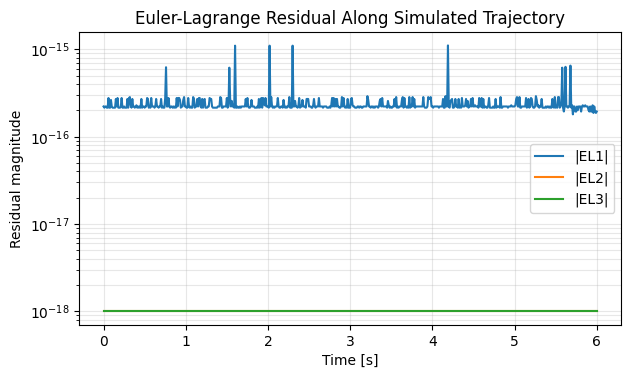

In [13]:
# EL implementation sanity check on the simulated trajectory
# Run this after the dynamics+animation cell above.
import numpy as np
import matplotlib.pyplot as plt

EL_func = sp.lambdify(dyn_args + (q1dd_s, q2dd_s, q3dd_s), EL_alg, 'numpy')

residuals = np.zeros((len(time_viz), 3), dtype=float)

for k, state in enumerate(traj):
    qdd_k = qdd_eval(state)
    vals = (
        state[0], state[1], state[2], state[3], state[4], state[5],
        params['g'], params['Lb'], params['Lc'], params['ma'], params['mb'], params['mc'],
        params['Ibx'], params['Iby'], params['Ibz'], params['Icx'], params['Icy'], params['Icz'],
        qdd_k[0], qdd_k[1], qdd_k[2]
    )
    residuals[k] = np.array(EL_func(*vals), dtype=float).reshape(3)

max_abs_each = np.max(np.abs(residuals), axis=0)
max_abs_all = float(np.max(np.abs(residuals)))

print('Max |EL residual| per equation:', max_abs_each)
print('Max |EL residual| overall     :', max_abs_all)

tol = 1e-6
if max_abs_all < tol:
    print(f'PASS: residuals are below tolerance ({tol}). Dynamics is consistent with EL implementation.')
else:
    print(f'WARN: residual exceeds tolerance ({tol}). Check model/solver settings.')

fig, ax = plt.subplots(figsize=(7, 3.8))
ax.semilogy(time_viz, np.maximum(np.abs(residuals[:, 0]), 1e-18), label='|EL1|')
ax.semilogy(time_viz, np.maximum(np.abs(residuals[:, 1]), 1e-18), label='|EL2|')
ax.semilogy(time_viz, np.maximum(np.abs(residuals[:, 2]), 1e-18), label='|EL3|')
ax.set_xlabel('Time [s]')
ax.set_ylabel('Residual magnitude')
ax.set_title('Euler-Lagrange Residual Along Simulated Trajectory')
ax.grid(True, which='both', alpha=0.3)
ax.legend()
plt.show()
